In [1]:
import os
import mne
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
print(__doc__)

Automatically created module for IPython interactive environment


In [2]:
def fetch(id):
    print('-' * 80)
    print(id)
    path = fifs[fifs['id'] == id]['rawica'].values[0]
    print(path)
    return path
fifs = pd.read_json('fifs.json')
fifs

,id,rawpath,rawica
0,QYJ_Test_1,rawdata/QYJ/MultiTest_1_raw_tsss.fif,raw_ica/QYJ_Test_1-afterica-raw.fif
1,QYJ_Test_2,rawdata/QYJ/MultiTest_2_raw_tsss.fif,raw_ica/QYJ_Test_2-afterica-raw.fif
2,QYJ_Test_3,rawdata/QYJ/MultiTest_3_raw_tsss.fif,raw_ica/QYJ_Test_3-afterica-raw.fif
3,QYJ_Test_4,rawdata/QYJ/MultiTest_4_raw_tsss.fif,raw_ica/QYJ_Test_4-afterica-raw.fif
4,QYJ_Test_5,rawdata/QYJ/MultiTest_5_raw_tsss.fif,raw_ica/QYJ_Test_5-afterica-raw.fif
5,QYJ_Test_6,rawdata/QYJ/MultiTest_6_raw_tsss.fif,raw_ica/QYJ_Test_6-afterica-raw.fif
6,QYJ_Test_7,rawdata/QYJ/MultiTest_7_raw_tsss.fif,raw_ica/QYJ_Test_7-afterica-raw.fif
7,QYJ_Test_8,rawdata/QYJ/MultiTest_8_raw_tsss.fif,raw_ica/QYJ_Test_8-afterica-raw.fif
8,QYJ_Training_1,rawdata/QYJ/MultiTraining_1_raw_tsss.fif,raw_ica/QYJ_Training_1-afterica-raw.fif
9,QYJ_Training_2,rawdata/QYJ/MultiTraining_2_raw_tsss.fif,raw_ica/QYJ_Training_2-afterica-raw.fif


--------------------------------------------------------------------------------
ZYF_Training_2
raw_ica/ZYF_Training_2-afterica-raw.fif
Opening raw data file raw_ica/ZYF_Training_2-afterica-raw.fif...
    Range : 8000 ... 226999 =      8.000 ...   226.999 secs
Ready.
Current compensation grade : 0
--------------------------------------------------------------------------------
ZYF_Training_4
raw_ica/ZYF_Training_4-afterica-raw.fif
Opening raw data file raw_ica/ZYF_Training_4-afterica-raw.fif...
    Range : 10000 ... 228999 =     10.000 ...   228.999 secs
Ready.
Current compensation grade : 0
Reading 0 ... 437999  =      0.000 ...   437.999 secs...
Effective window size : 2.048 (s)
Effective window size : 2.048 (s)
148 events found
Event IDs: [ 2  6  9 11 14 17 19 33 35]


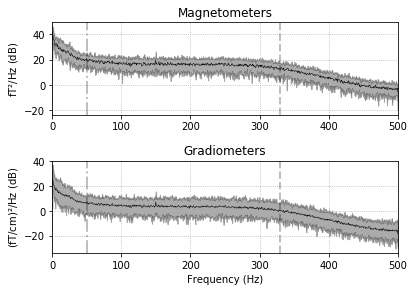

In [3]:
raw = mne.concatenate_raws([mne.io.read_raw_fif(fetch('ZYF_Training_{}'.format(j))) for j in [2, 4]])
raw.load_data()
raw.plot_psd(area_mode='range', tmax=10.0, show=False, average=True)
events = mne.find_events(raw)

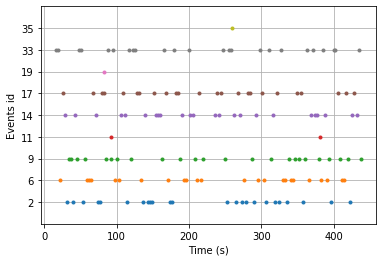

In [9]:
f = mne.viz.plot_events(events, sfreq=raw.info['sfreq'])

148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 148 events and 1501 original time points ...
0 bad epochs dropped
Subtracting Evoked from Epochs
    The following channels are not included in the subtraction: STI003, STI001, IASY-, STI101, STI006, STI007, IAS_X, IAS_Y, IAS_DX, STI008, SYS201, IASY+, IAS_DY, STI004, IASX-, STI002, IASZ-, IASX+, IAS_Z, STI005, BIO001, IASZ+
[done]
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 148 events and 1501 original time points ...
0 bad epochs dropped
Subtracting Evoked from Epochs
    The following channels are not included in the subtraction: STI003, STI001, IASY-, STI101, STI006, STI007, IAS_X, IAS_Y, IAS_DX, STI008, SYS201, IASY+, IAS_DY, STI004, IASX-, STI002, IASZ-, IASX+, IAS_Z, STI005, BIO001, IASZ+
[done]
148 matching events found
Applying baseline correction (mode: 

Text(0.5, 0, 'Time [ms]')

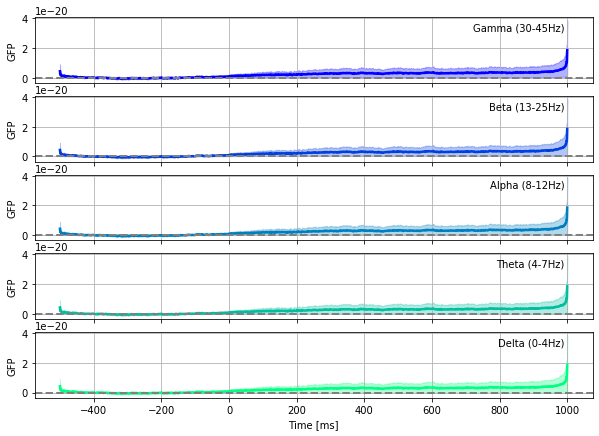

In [10]:
iter_freqs = [
    ('Delta', 0, 4),
    ('Theta', 4, 7),
    ('Alpha', 8, 12),
    ('Beta', 13, 25),
    ('Gamma', 30, 45)
]
tmin, tmax = -0.5, 1.0

frequency_map = []

for band, fmin, fmax in iter_freqs:
    _epochs = mne.Epochs(raw, events=events, tmin=tmin, tmax=tmax, preload=True)
    _epochs.subtract_evoked()
    _epochs.apply_hilbert(envelope=True)
    frequency_map.append(((band, fmin, fmax), _epochs.average()))
    del _epochs
    
# Helper function for plotting spread
def stat_fun(x):
    """Return sum of squares."""
    return np.sum(x ** 2, axis=0)

# Plot
fig, axes = plt.subplots(5, 1, figsize=(10, 7), sharex=True, sharey=True)
colors = plt.get_cmap('winter_r')(np.linspace(0, 1, 5))
for ((freq_name, fmin, fmax), average), color, ax in zip(
        frequency_map, colors, axes.ravel()[::-1]):
    times = average.times * 1e3
    gfp = np.sum(average.data ** 2, axis=0)
    gfp = mne.baseline.rescale(gfp, times, baseline=(None, 0))
    ax.plot(times, gfp, label=freq_name, color=color, linewidth=2.5)
    ax.axhline(0, linestyle='--', color='grey', linewidth=2)
    ci_low, ci_up = mne.stats.bootstrap_confidence_interval(average.data, random_state=0,
                                                  stat_fun=stat_fun)
    ci_low = mne.baseline.rescale(ci_low, average.times, baseline=(None, 0))
    ci_up = mne.baseline.rescale(ci_up, average.times, baseline=(None, 0))
    ax.fill_between(times, gfp + ci_up, gfp - ci_low, color=color, alpha=0.3)
    ax.grid(True)
    ax.set_ylabel('GFP')
    ax.annotate('%s (%d-%dHz)' % (freq_name, fmin, fmax),
                xy=(0.95, 0.8),
                horizontalalignment='right',
                xycoords='axes fraction')

axes.ravel()[-1].set_xlabel('Time [ms]')

148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
2
Loading data for 24 events and 701 original time points ...
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Loading data for 24 events and 701 original time points ...
    Using multitaper spectrum estimation with 7 DPSS windows


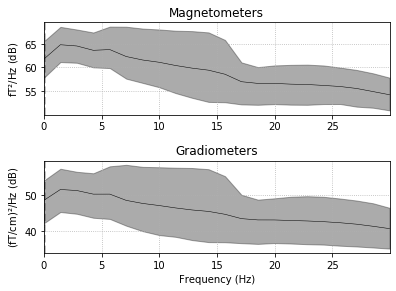

6
Loading data for 24 events and 701 original time points ...
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Loading data for 24 events and 701 original time points ...
    Using multitaper spectrum estimation with 7 DPSS windows


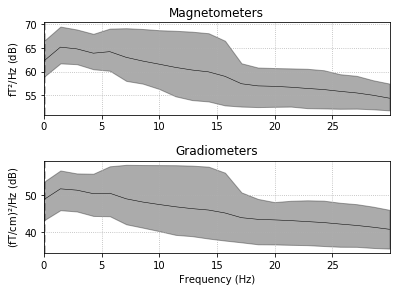

9
Loading data for 24 events and 701 original time points ...
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Loading data for 24 events and 701 original time points ...
    Using multitaper spectrum estimation with 7 DPSS windows


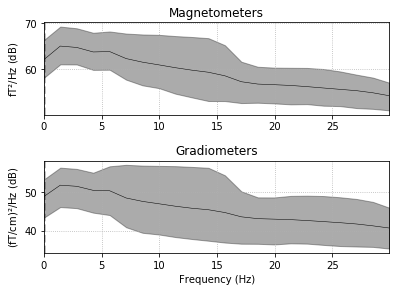

11
Loading data for 2 events and 701 original time points ...
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Loading data for 2 events and 701 original time points ...
    Using multitaper spectrum estimation with 7 DPSS windows


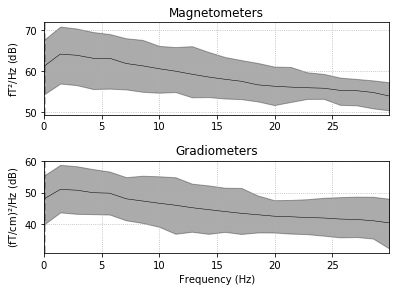

14
Loading data for 24 events and 701 original time points ...
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Loading data for 24 events and 701 original time points ...
    Using multitaper spectrum estimation with 7 DPSS windows


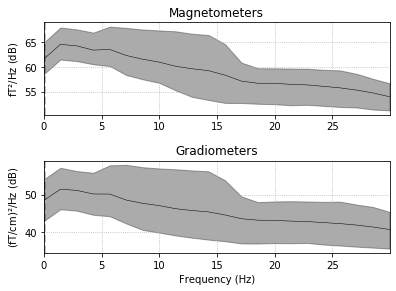

17
Loading data for 24 events and 701 original time points ...
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Loading data for 24 events and 701 original time points ...
    Using multitaper spectrum estimation with 7 DPSS windows


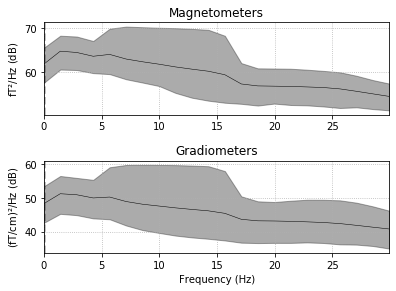

19
Loading data for 1 events and 701 original time points ...
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Loading data for 1 events and 701 original time points ...
    Using multitaper spectrum estimation with 7 DPSS windows


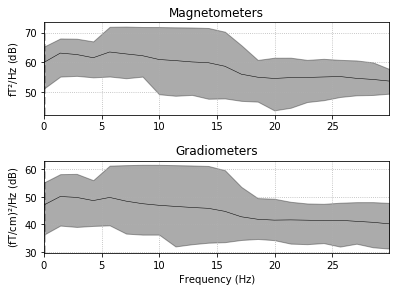

33
Loading data for 24 events and 701 original time points ...
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Loading data for 24 events and 701 original time points ...
    Using multitaper spectrum estimation with 7 DPSS windows


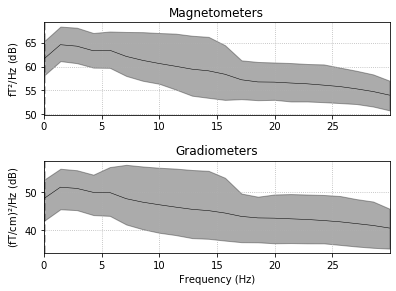

35
Loading data for 1 events and 701 original time points ...
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Loading data for 1 events and 701 original time points ...
    Using multitaper spectrum estimation with 7 DPSS windows


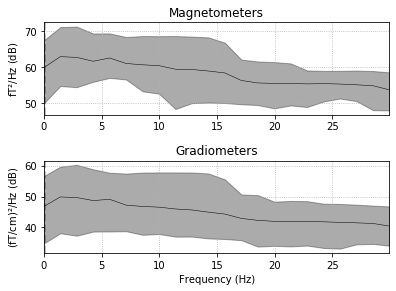

<Epochs  |   148 events (good & bad), -0.2 - 0.5 sec, baseline [None, 0], ~5.5 MB, data not loaded,
 '11': 2
 '14': 24
 '17': 24
 '19': 1
 '2': 24
 '33': 24
 '35': 1
 '6': 24
 '9': 24>

In [11]:
epochs = mne.Epochs(raw, events=events)
event_id = epochs.event_id
times = epochs.times
for event in event_id:
    print(event)
    epochs[event].plot_psd(area_mode='range', fmin=0, fmax=30, spatial_colors=True, average=True)
epochs

--------------------------------------------------------------------------------
('Delta', 0, 4)
Filtering raw data in 2 contiguous segments
Setting up low-pass filter at 4 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 4.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 5.00 Hz)
- Filter length: 1651 samples (1.651 sec)

2
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '2' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


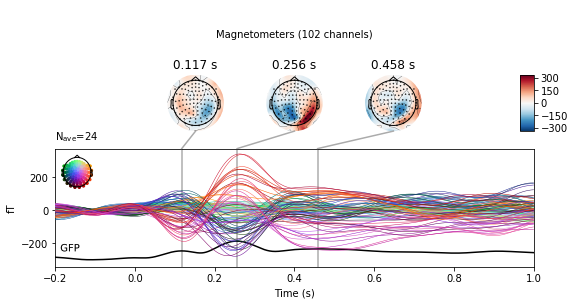

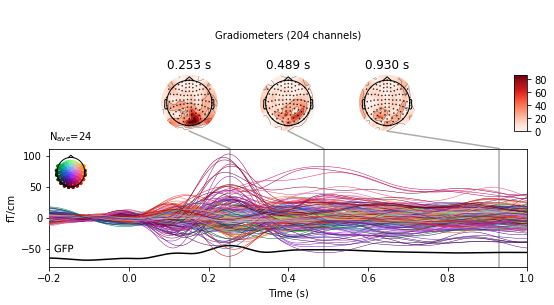

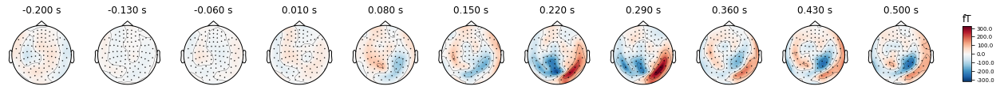

6
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '6' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


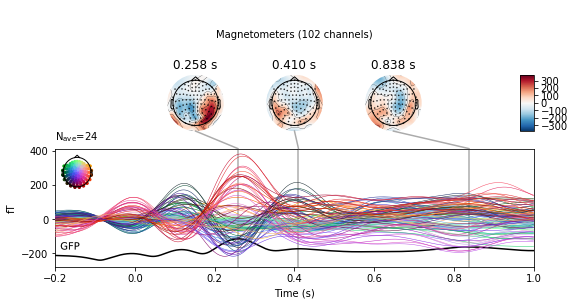

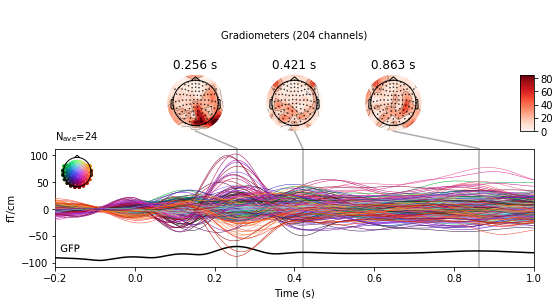

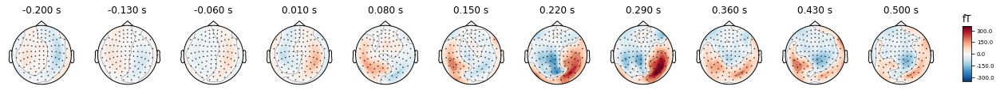

9
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '9' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


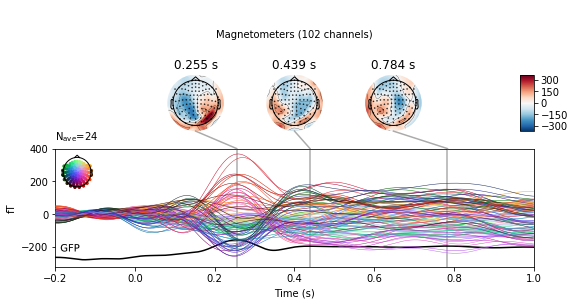

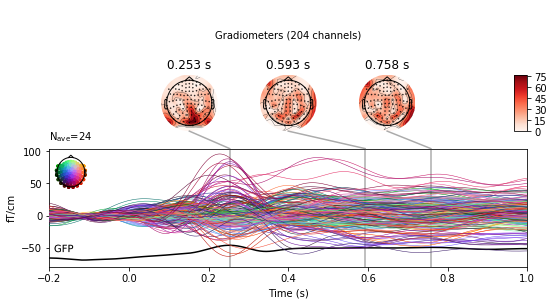

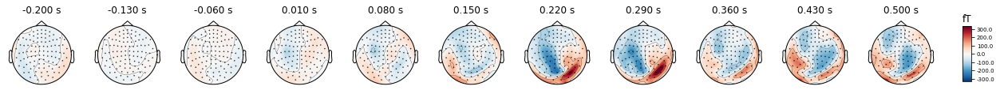

11
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '11' (average, N=2), [-0.2, 1] sec, 306 ch, ~8.3 MB>


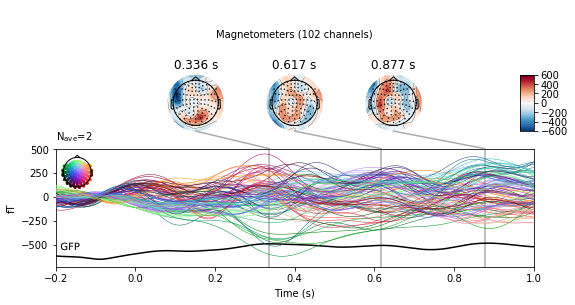

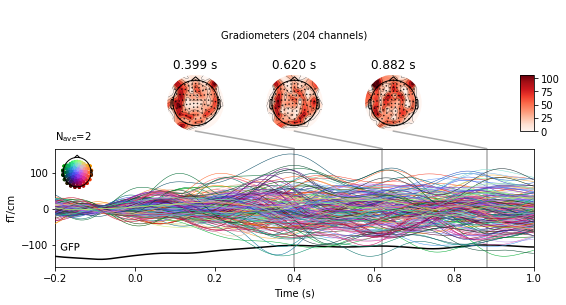

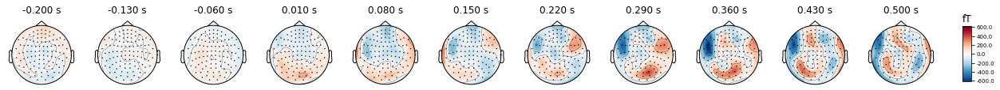

14
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '14' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


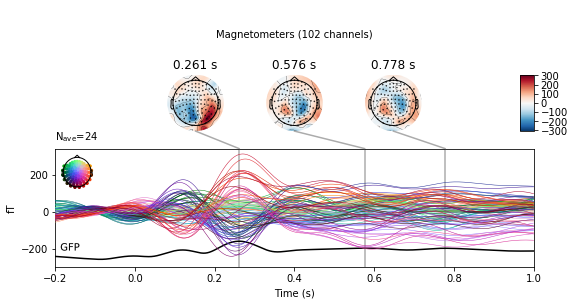

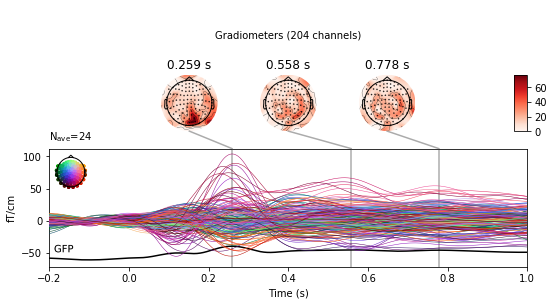

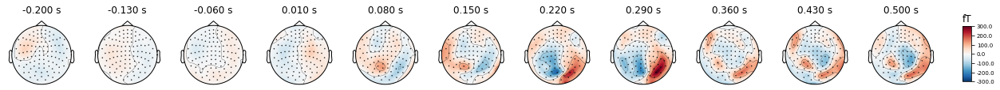

17
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '17' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


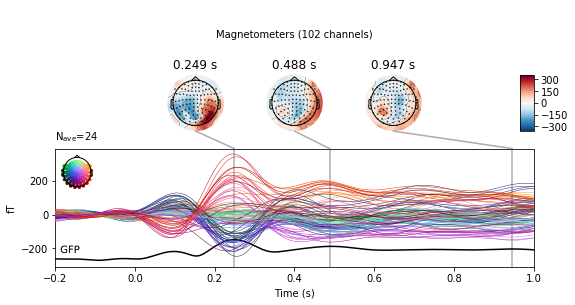

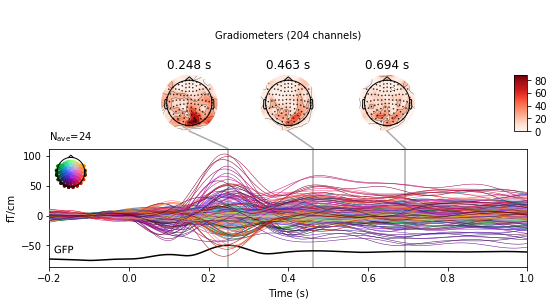

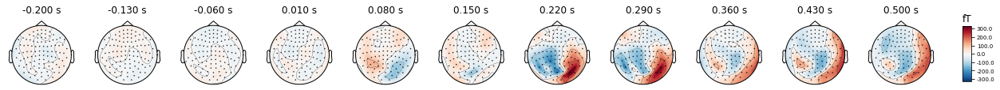

19
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '19' (average, N=1), [-0.2, 1] sec, 306 ch, ~8.3 MB>


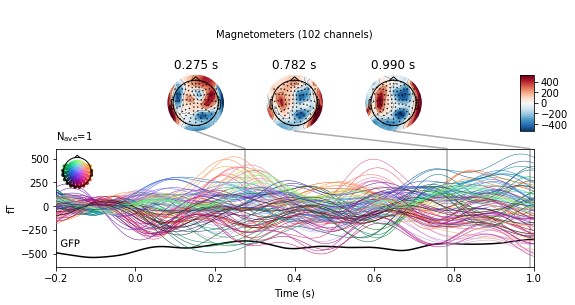

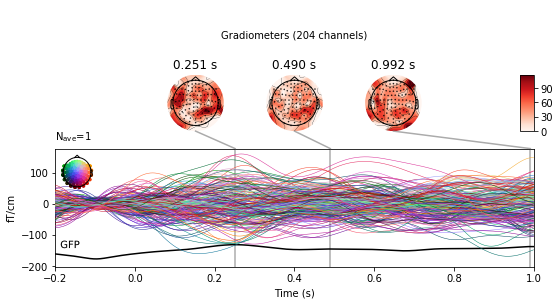

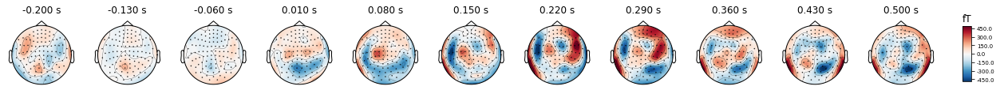

33
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '33' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


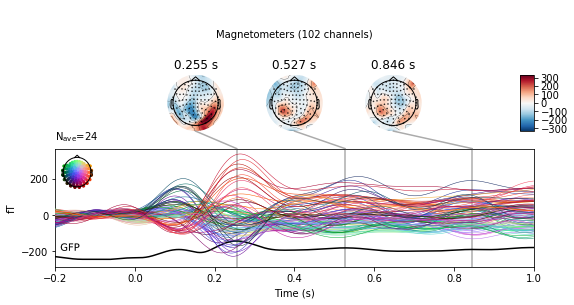

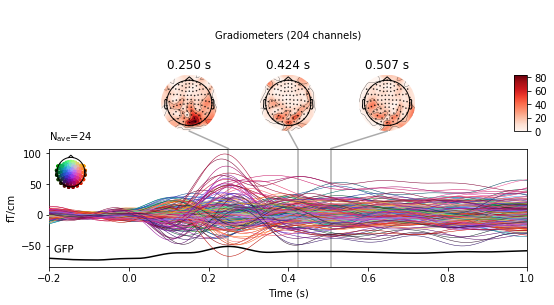

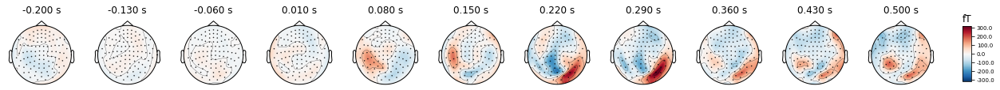

35
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '35' (average, N=1), [-0.2, 1] sec, 306 ch, ~8.3 MB>


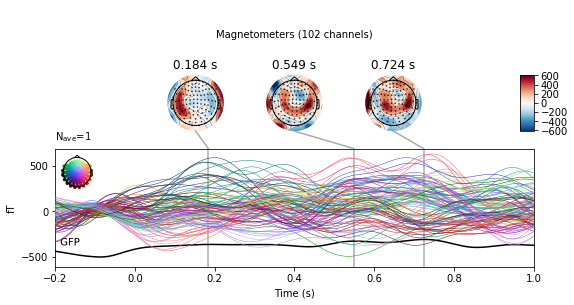

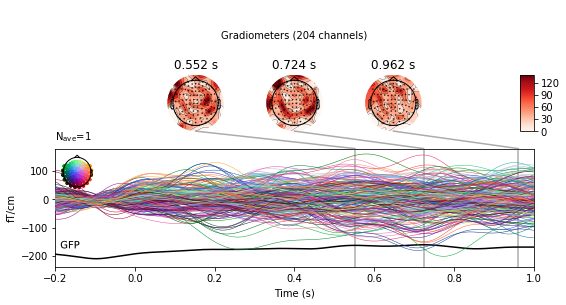

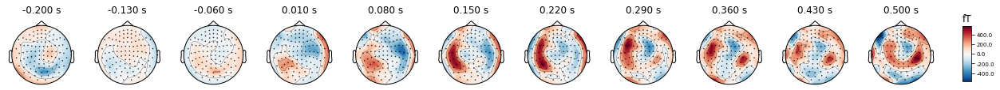

--------------------------------------------------------------------------------
('Theta', 4, 7)
Filtering raw data in 2 contiguous segments
Setting up band-pass filter from 4 - 7 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 7.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 8.00 Hz)
- Filter length: 1651 samples (1.651 sec)

2
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '2' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


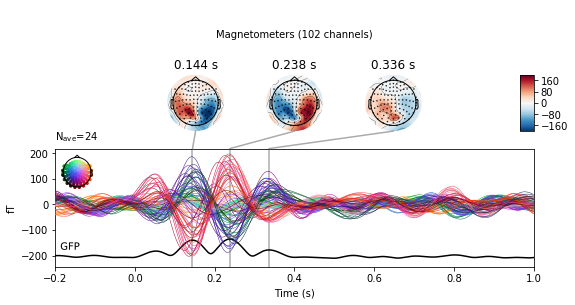

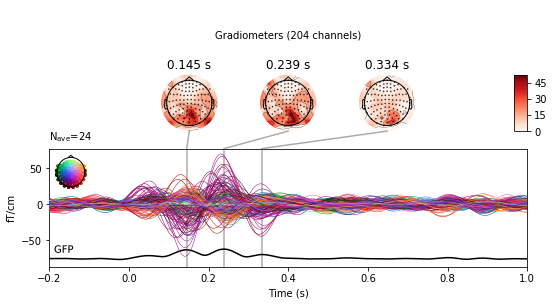

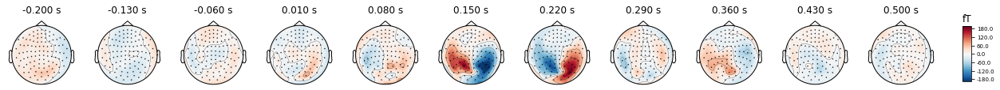

6
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '6' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


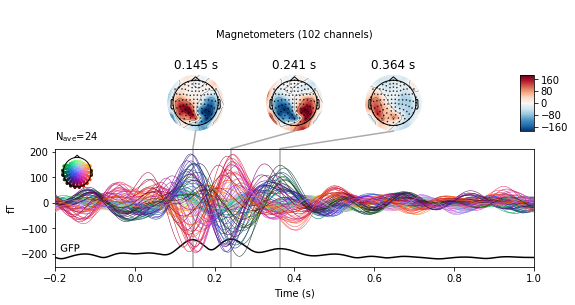

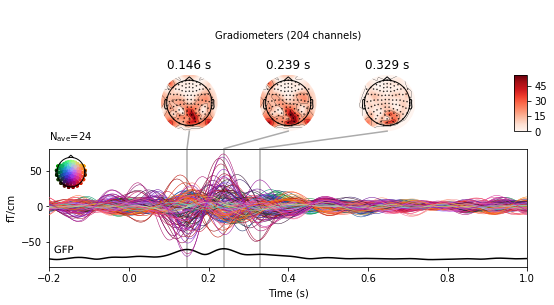

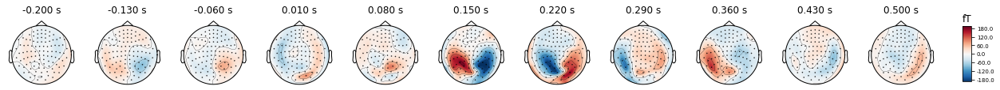

9
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '9' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


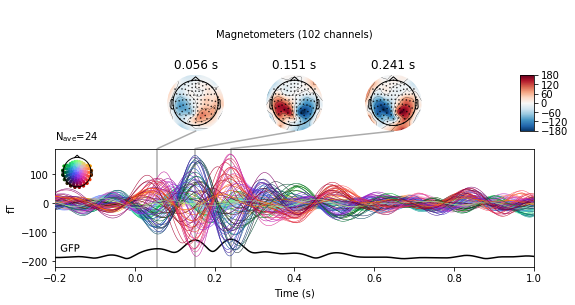

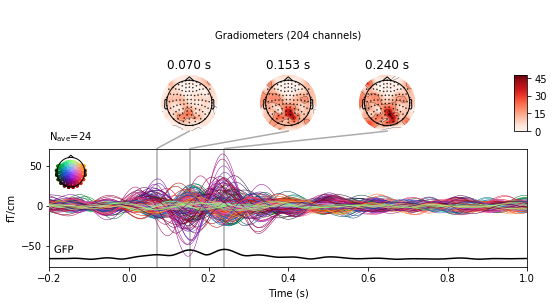

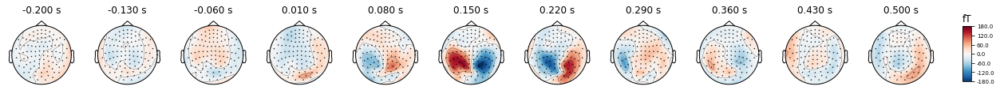

11
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '11' (average, N=2), [-0.2, 1] sec, 306 ch, ~8.3 MB>


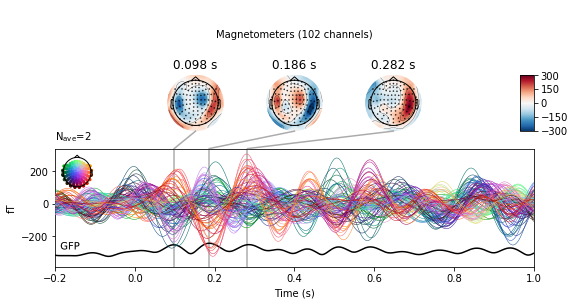

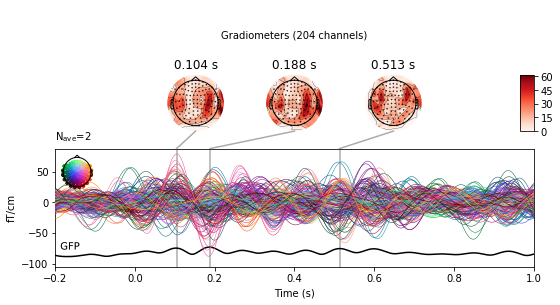

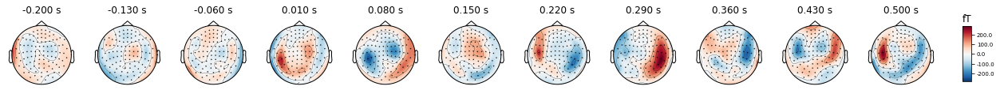

14
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '14' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


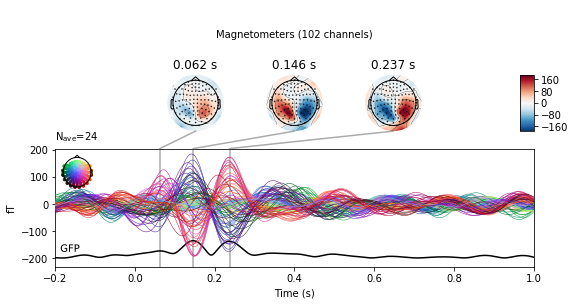

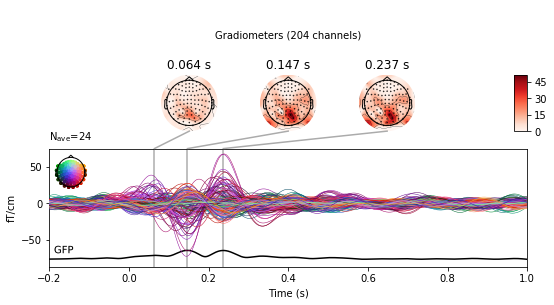

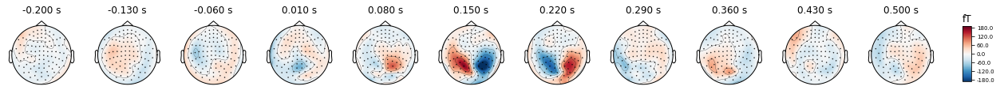

17
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '17' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


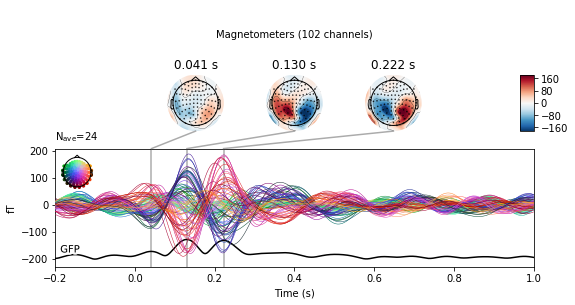

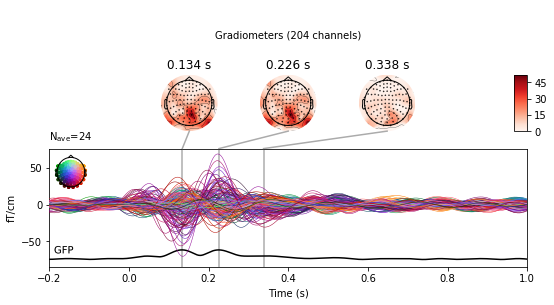

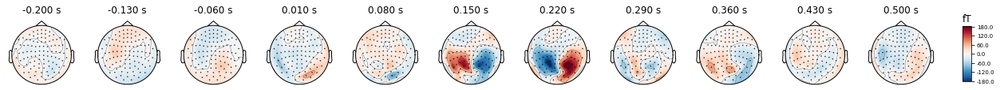

19
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '19' (average, N=1), [-0.2, 1] sec, 306 ch, ~8.3 MB>


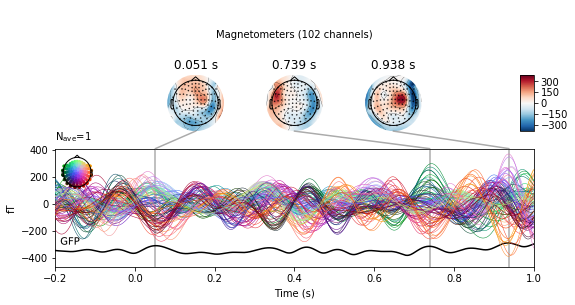

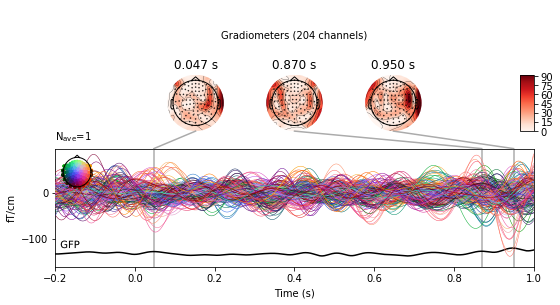

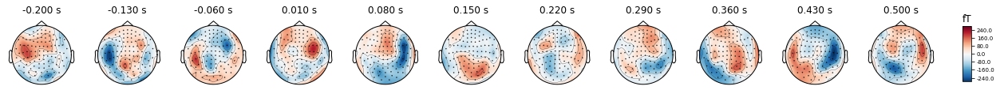

33
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '33' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


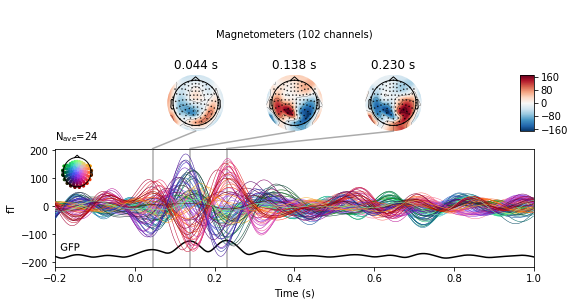

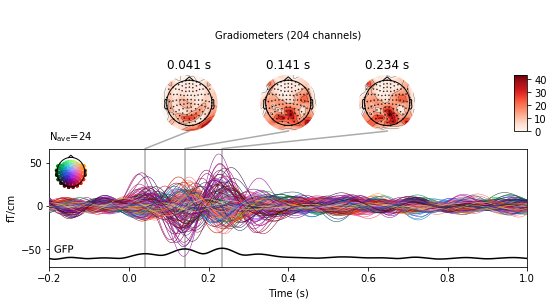

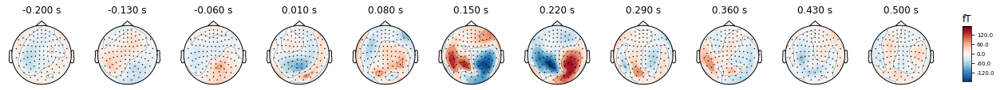

35
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '35' (average, N=1), [-0.2, 1] sec, 306 ch, ~8.3 MB>


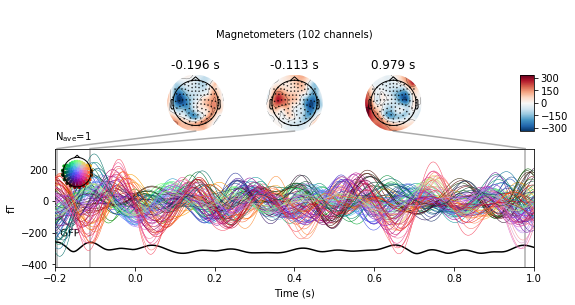

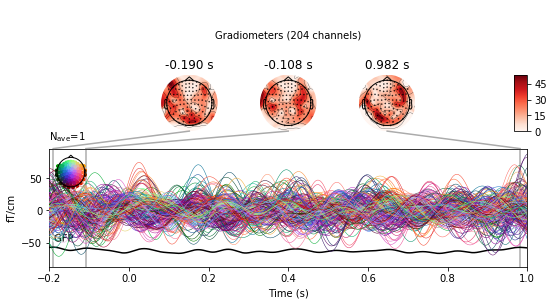

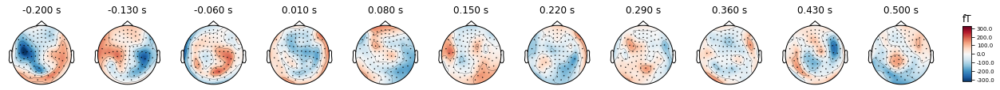

--------------------------------------------------------------------------------
('Alpha', 8, 12)
Filtering raw data in 2 contiguous segments
Setting up band-pass filter from 8 - 12 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 8.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 7.00 Hz)
- Upper passband edge: 12.00 Hz
- Upper transition bandwidth: 3.00 Hz (-6 dB cutoff frequency: 13.50 Hz)
- Filter length: 1651 samples (1.651 sec)

2
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '2' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


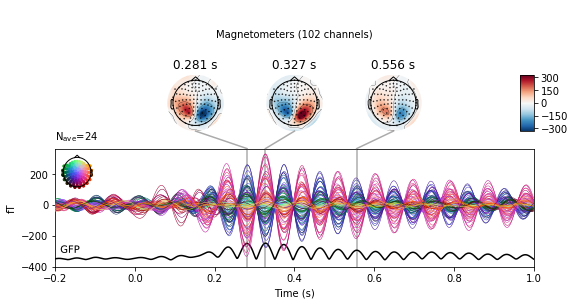

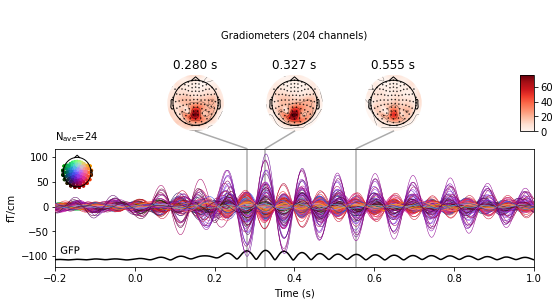

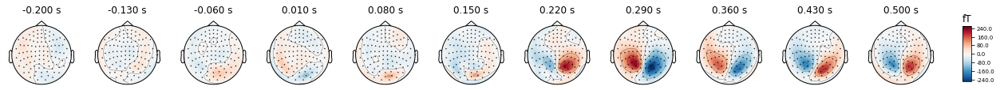

6
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '6' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


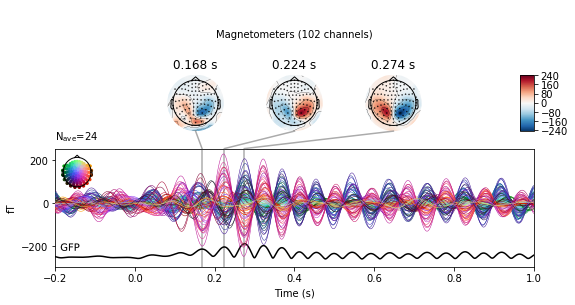

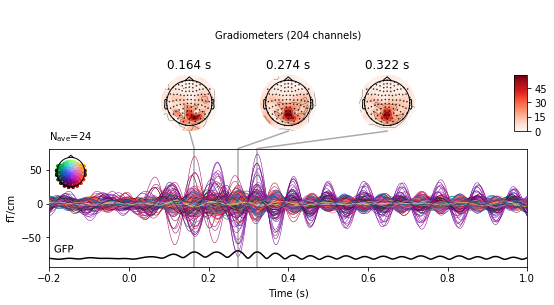

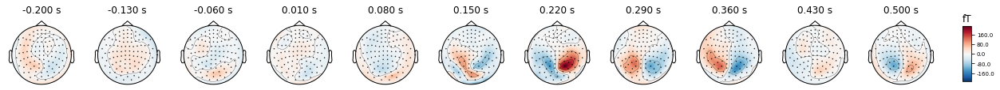

9
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '9' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


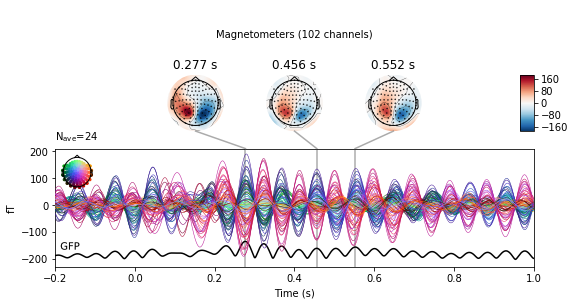

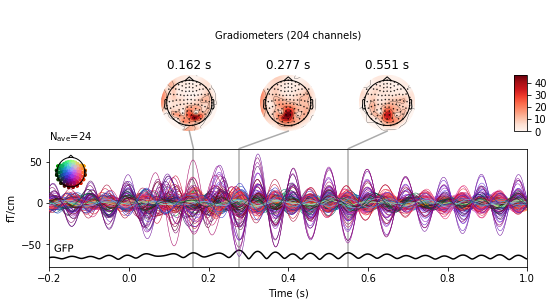

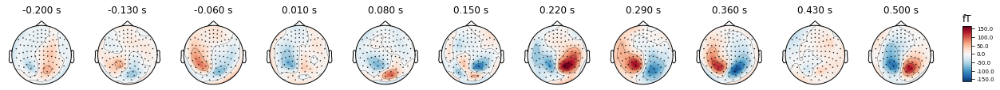

11
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '11' (average, N=2), [-0.2, 1] sec, 306 ch, ~8.3 MB>


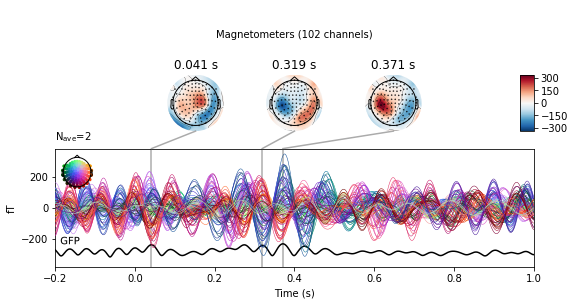

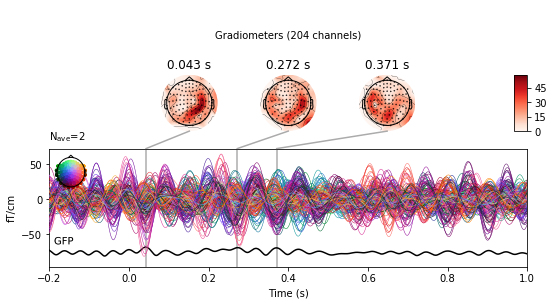

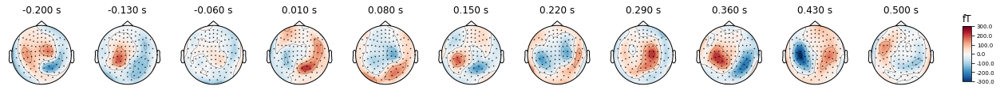

14
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '14' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


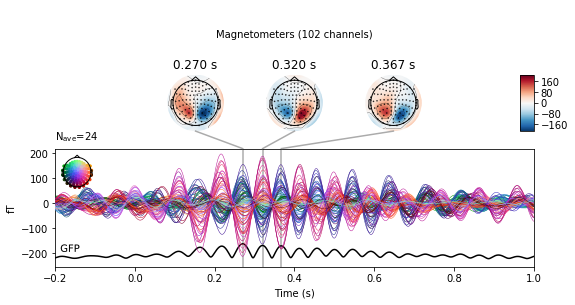

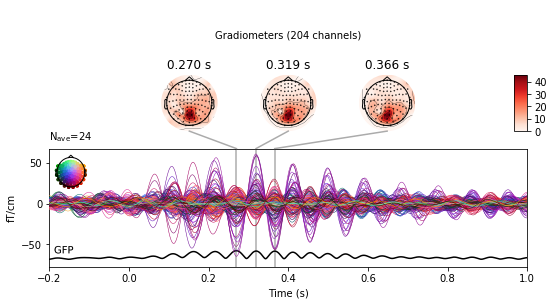

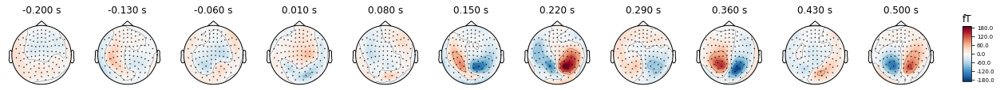

17
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '17' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


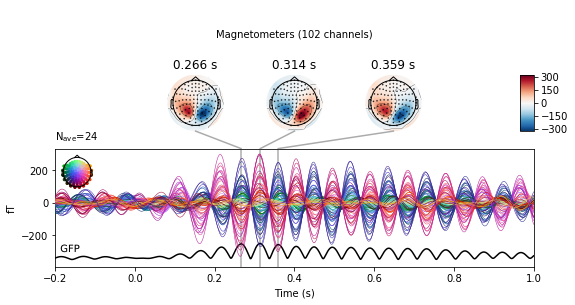

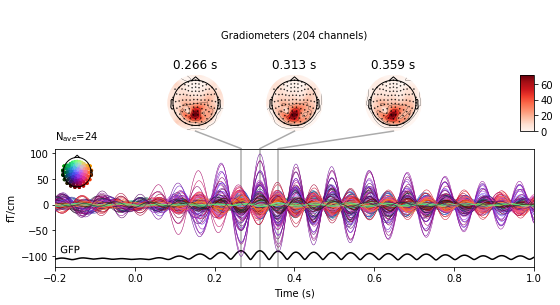

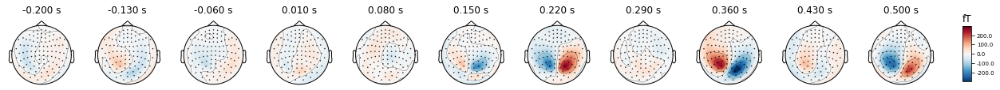

19
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '19' (average, N=1), [-0.2, 1] sec, 306 ch, ~8.3 MB>


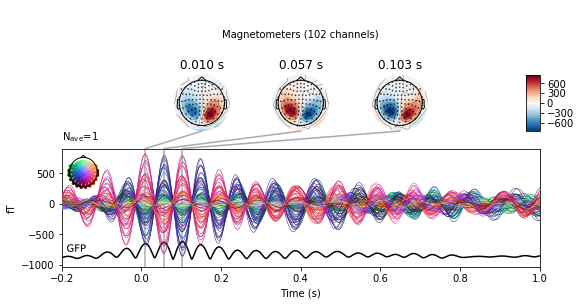

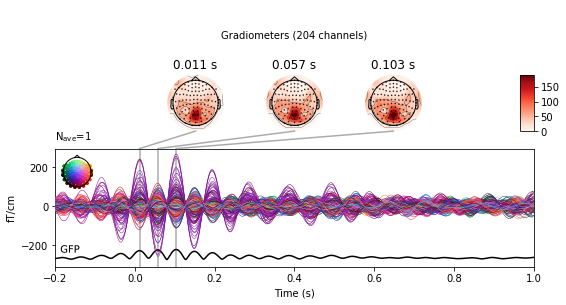

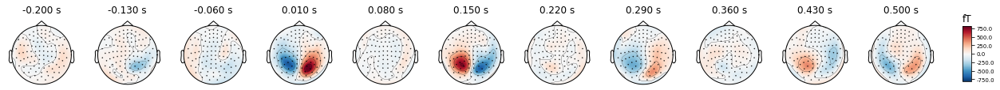

33
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '33' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


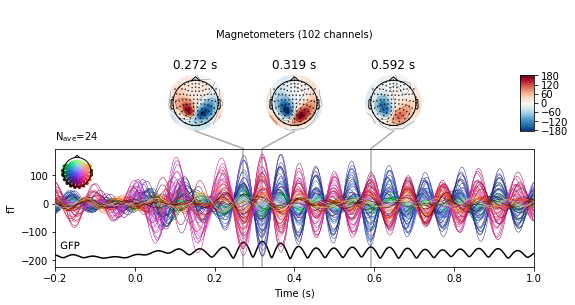

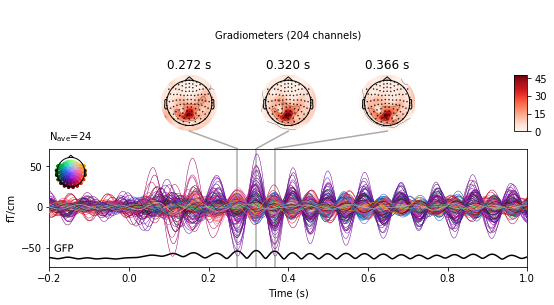

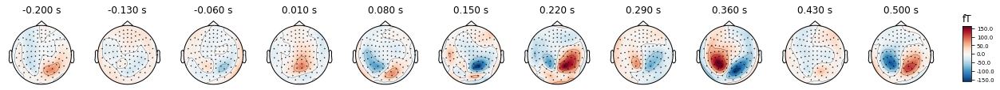

35
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '35' (average, N=1), [-0.2, 1] sec, 306 ch, ~8.3 MB>


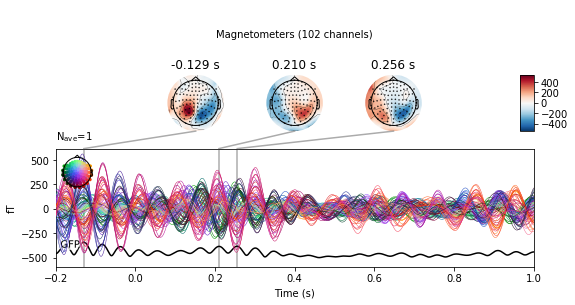

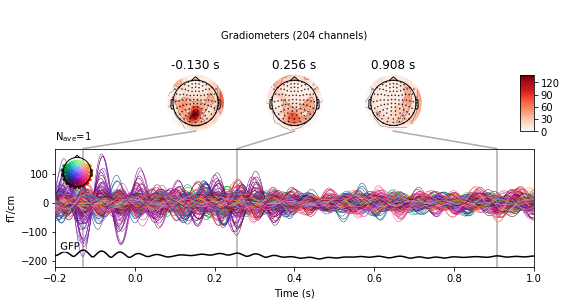

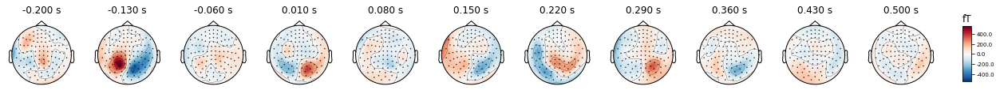

--------------------------------------------------------------------------------
('Beta', 13, 25)
Filtering raw data in 2 contiguous segments
Setting up band-pass filter from 13 - 25 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 13.00
- Lower transition bandwidth: 3.25 Hz (-6 dB cutoff frequency: 11.38 Hz)
- Upper passband edge: 25.00 Hz
- Upper transition bandwidth: 6.25 Hz (-6 dB cutoff frequency: 28.12 Hz)
- Filter length: 1015 samples (1.015 sec)

2
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '2' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


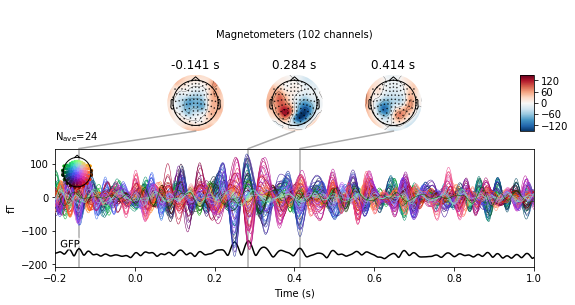

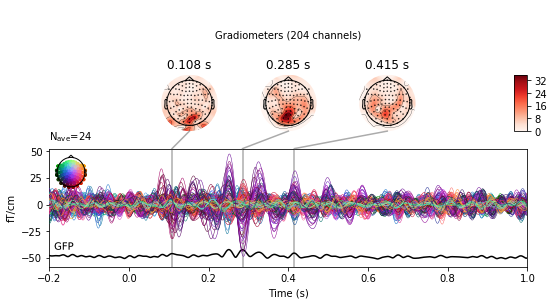

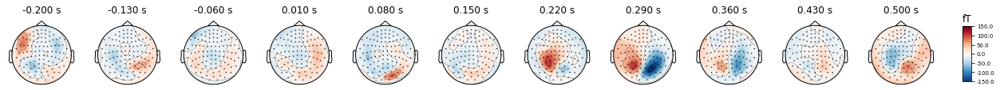

6
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '6' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


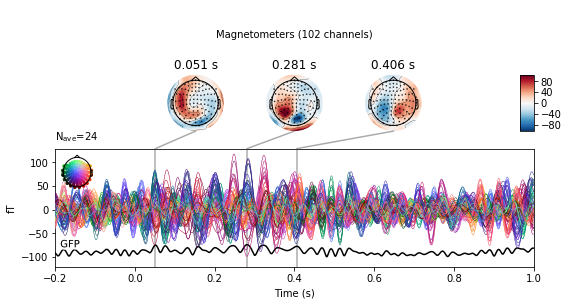

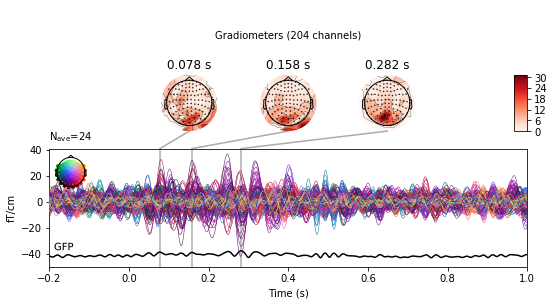

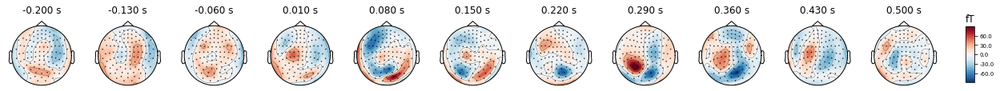

9
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '9' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


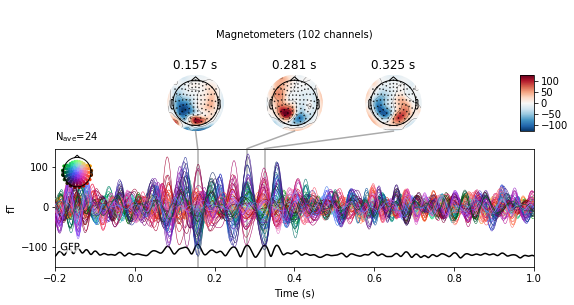

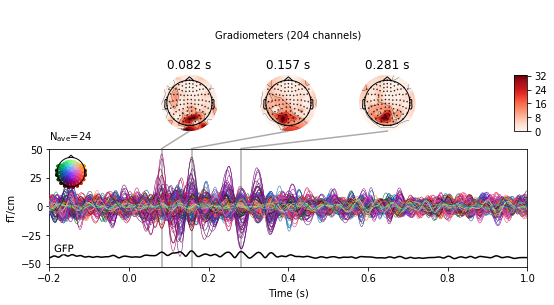

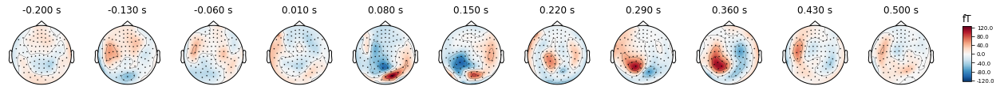

11
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '11' (average, N=2), [-0.2, 1] sec, 306 ch, ~8.3 MB>


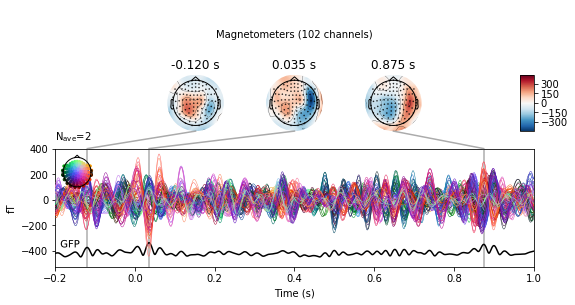

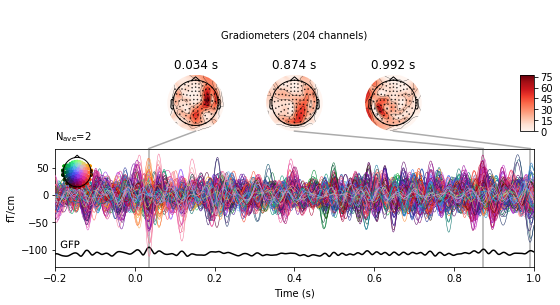

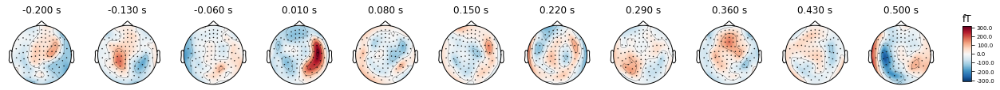

14
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '14' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


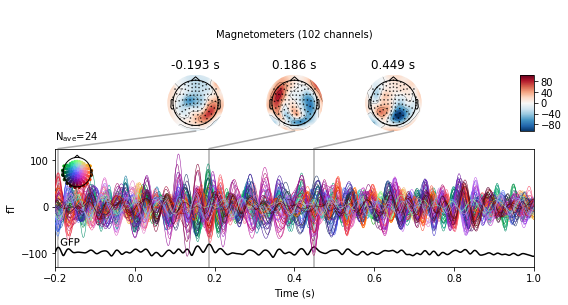

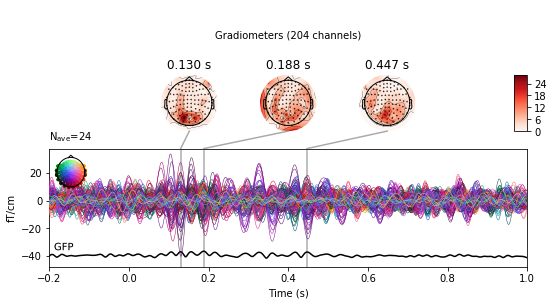

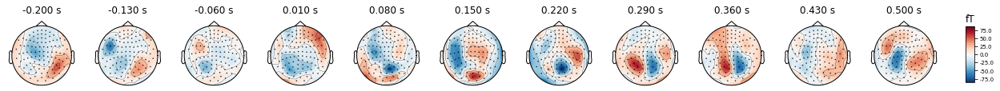

17
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '17' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


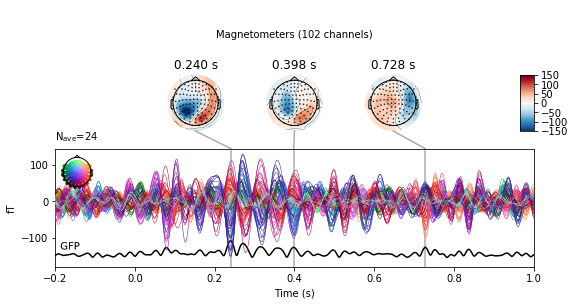

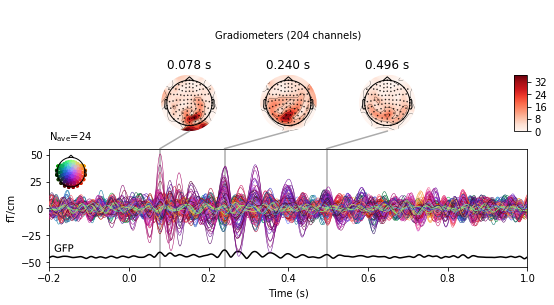

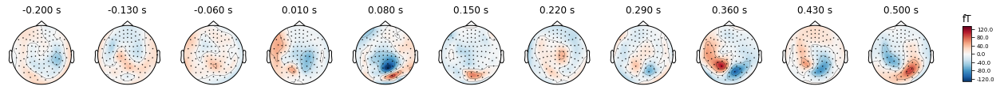

19
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '19' (average, N=1), [-0.2, 1] sec, 306 ch, ~8.3 MB>


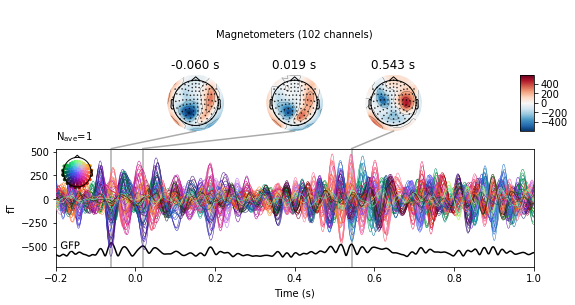

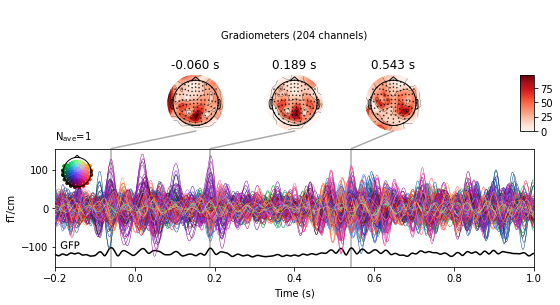

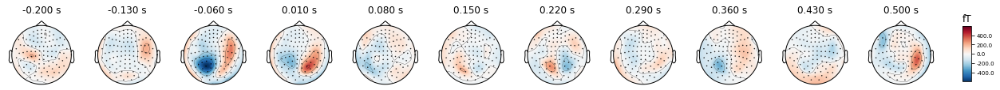

33
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '33' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


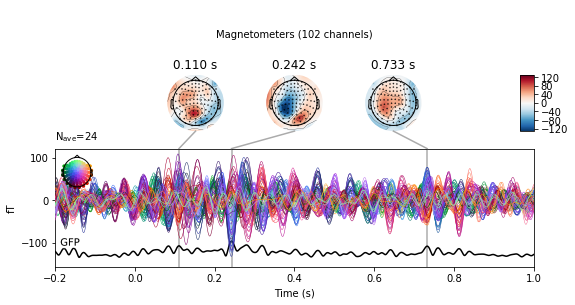

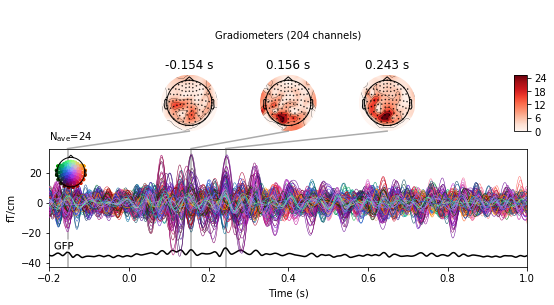

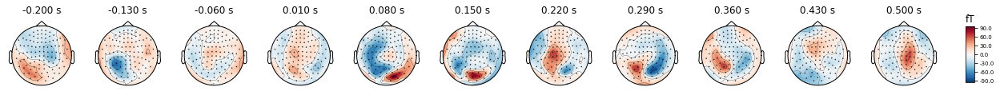

35
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '35' (average, N=1), [-0.2, 1] sec, 306 ch, ~8.3 MB>


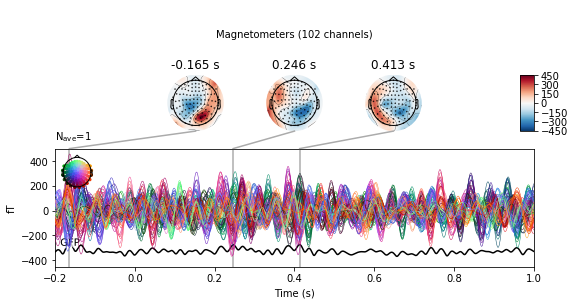

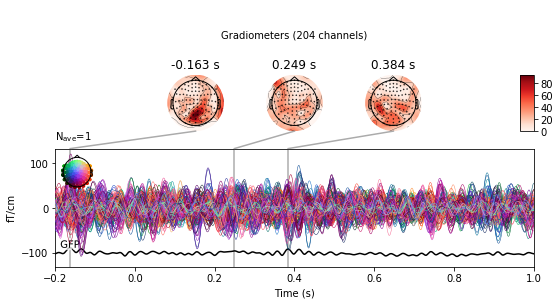

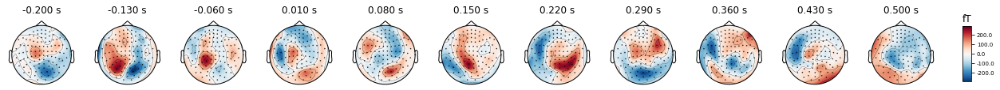

--------------------------------------------------------------------------------
('Gamma', 30, 45)
Filtering raw data in 2 contiguous segments
Setting up band-pass filter from 30 - 45 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 30.00
- Lower transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 26.25 Hz)
- Upper passband edge: 45.00 Hz
- Upper transition bandwidth: 11.25 Hz (-6 dB cutoff frequency: 50.62 Hz)
- Filter length: 441 samples (0.441 sec)

2
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '2' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


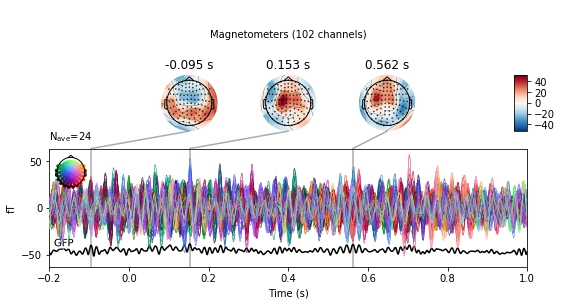

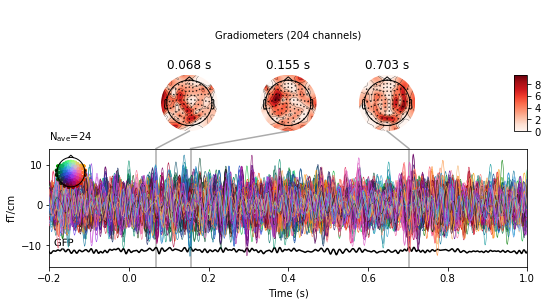

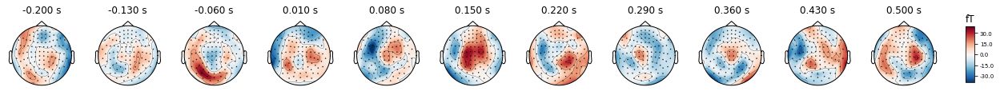

6
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '6' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


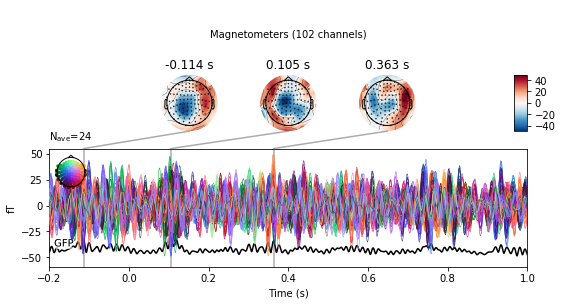

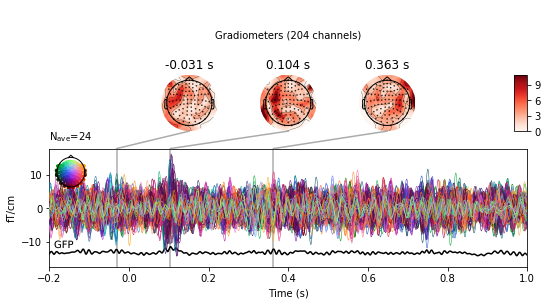

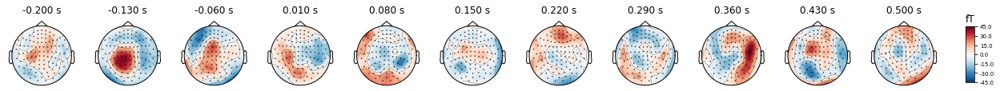

9
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '9' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


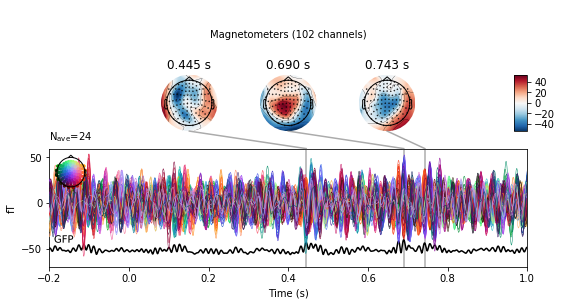

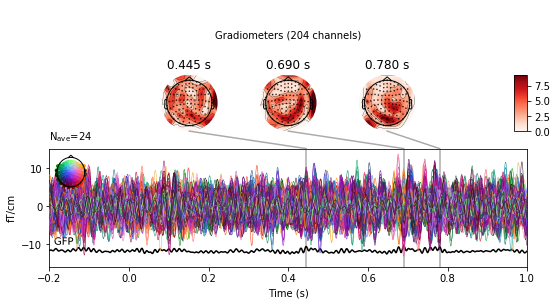

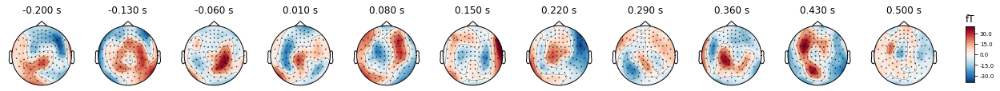

11
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '11' (average, N=2), [-0.2, 1] sec, 306 ch, ~8.3 MB>


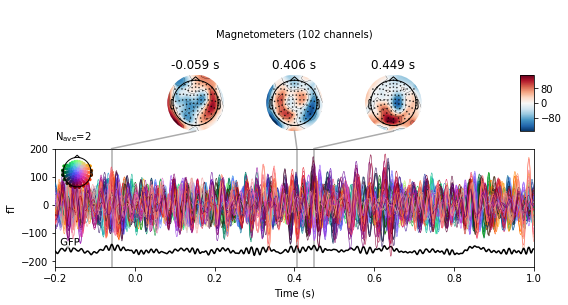

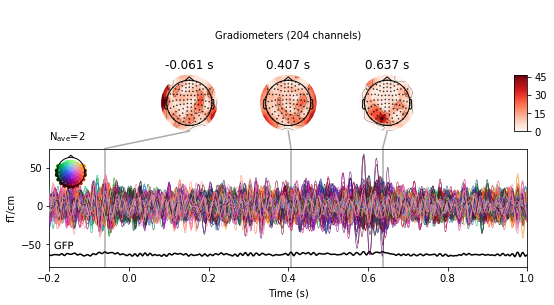

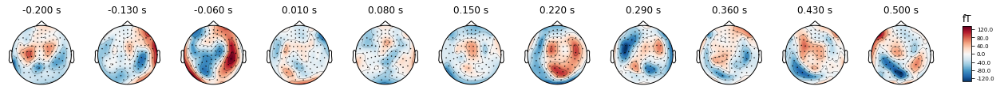

14
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '14' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


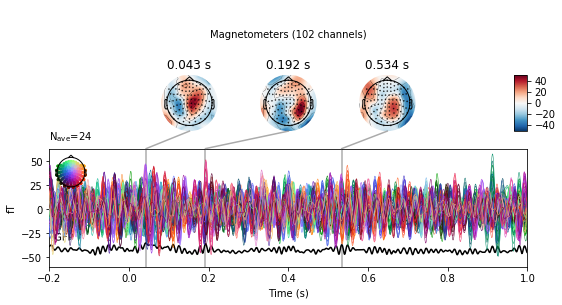

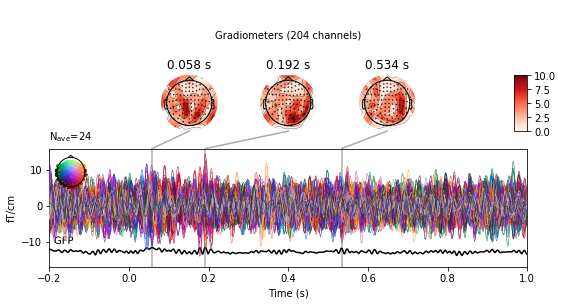

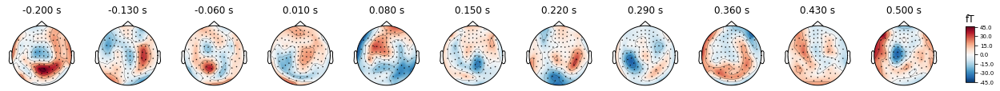

17
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '17' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


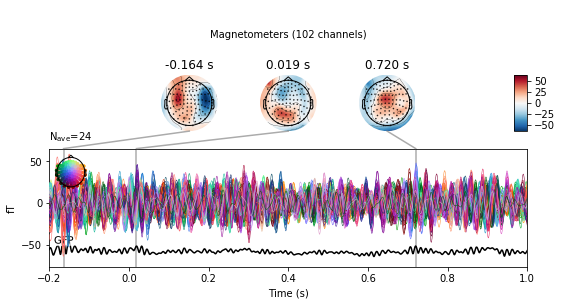

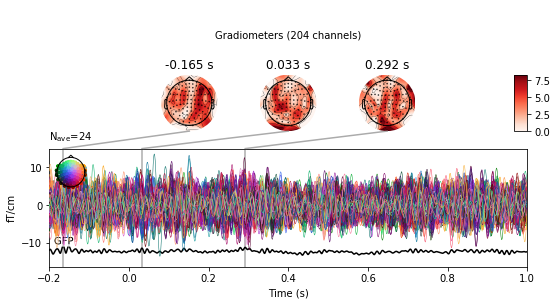

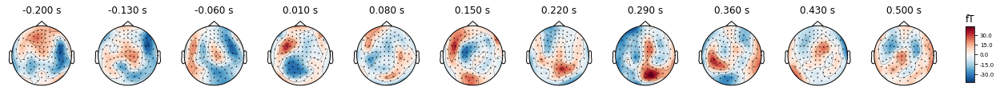

19
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '19' (average, N=1), [-0.2, 1] sec, 306 ch, ~8.3 MB>


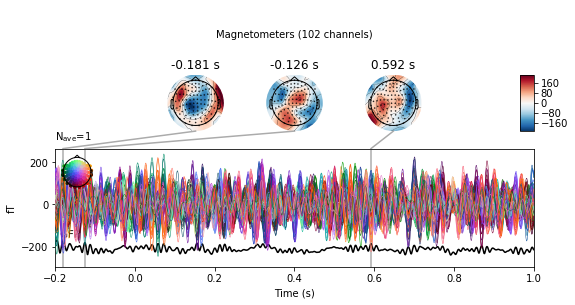

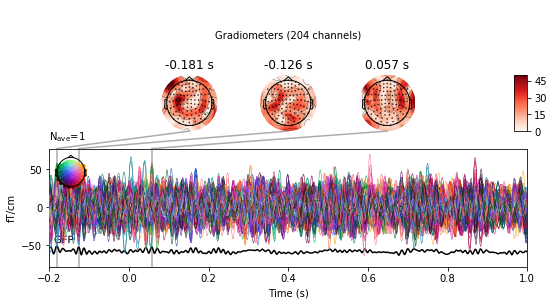

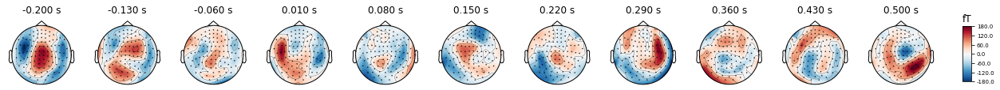

33
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '33' (average, N=24), [-0.2, 1] sec, 306 ch, ~8.3 MB>


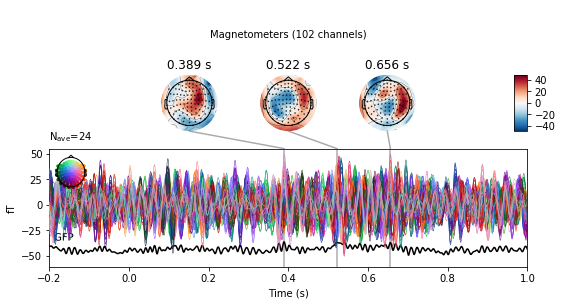

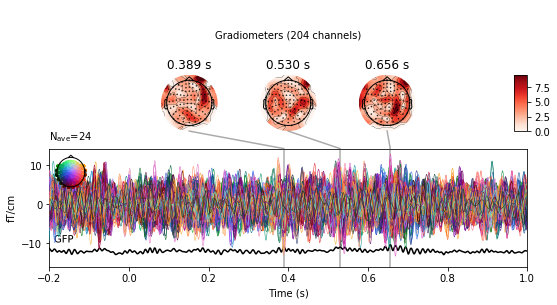

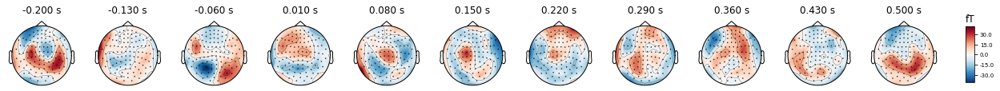

35
148 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
<Evoked  |  '35' (average, N=1), [-0.2, 1] sec, 306 ch, ~8.3 MB>


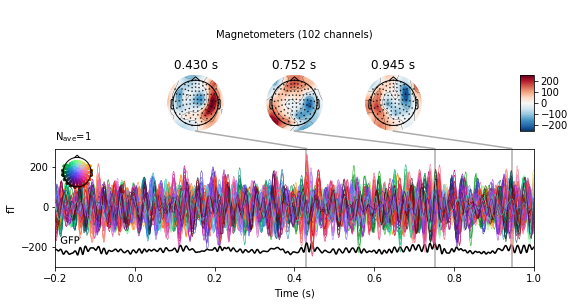

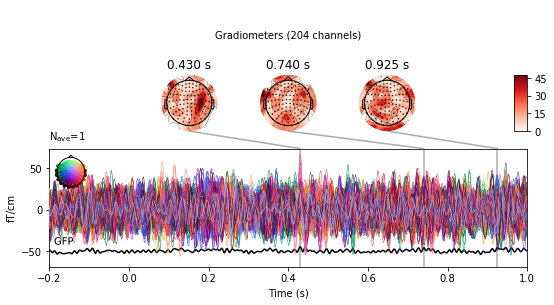

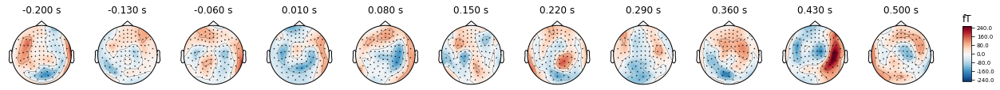

In [13]:
for freqs in iter_freqs:
    print('-' * 80)
    print(freqs)
    _raw = raw.copy()
    _raw.load_data()
    _raw.filter(l_freq=freqs[1], h_freq=freqs[2])
    for event in event_id:
        print(event)
        _epochs = mne.Epochs(_raw, events=events, tmin=-0.2, tmax=1.0)
        evoked = _epochs[event].average()
        print(evoked)
        evoked.plot_joint(ts_args=dict(gfp=True))
        evoked.plot_topomap(times[::70])